<a href="https://colab.research.google.com/github/Muhirwakyeyune/Deep_Learning/blob/main/GAN_implementation_AMMI2023.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Deep Convolutional Generative Adverserial Networks (DC-GAN)

In this notebook, we will implement a DCGAN. DCGAN is a direct extension of GAN model. It uses convolutional and convolutional-transpose layers in the discriminator and generator.

In [ ]:
#For mnist dataset
from google.colab import drive
drive.mount('/content/drive')

# Import packages

In [ ]:
from __future__ import print_function
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
random.seed(999)
torch.manual_seed(999)

# Set the parameters

In [ ]:
# Use GPU if available 
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Number of workers for dataloader
workers = 2

batch_size = 128

image_size = 64

num_channels = 1

size_of_z = 100 

fea_map_size = 64

num_epochs = 5 

learning_rate = 0.0002
 
beta1 = 0.5 #For Adam optimizers

numb_gpu = 1 

In [ ]:
dataset_mnist = datasets.MNIST(root='/content/drive/MyDrive/Data/mnist', download=False,
                        transform=transforms.Compose([
                        transforms.Resize(image_size),
                        transforms.ToTensor(),
                        transforms.Normalize((0.5,), (0.5,))
                        ]))

dataloader_mnist = torch.utils.data.DataLoader(dataset_mnist, batch_size=batch_size,
                                            shuffle=True, num_workers=workers)

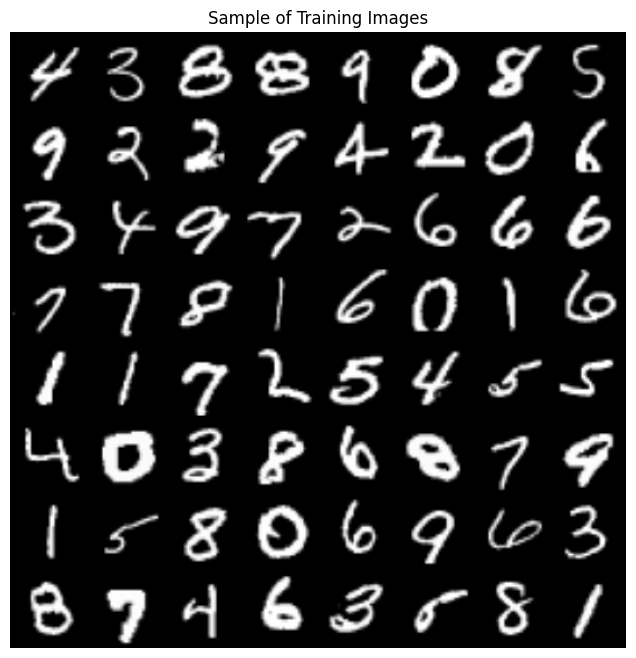

In [ ]:
# Plot some training images
samples = next(iter(dataloader_mnist))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Sample of Training Images")
plt.imshow(np.transpose(vutils.make_grid(samples[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [ ]:
#Note: We implemented this dataset in our local machine. Then, we uploaded it.
dataroot='CelebA'

num_channels = 3

dataset_celeba = datasets.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader_celeba = torch.utils.data.DataLoader(dataset_celeba, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

In [ ]:
# Plot some training images
real_batch = next(iter(dataloader_celeba))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))


# Implementation

Weight Initialization

In [ ]:
#weights initialization
def initalize_weights(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02) #Initialize the weights to mean=0, sd=0.02
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Generator Network

In [ ]:
class Generator_Net(nn.Module):
    def __init__(self, ngpu):
        super(Generator_Net, self).__init__()
        self.ngpu = ngpu
        self.transpose_conv = nn.Sequential(
            #First transpose convolutional layer
            nn.ConvTranspose2d( size_of_z, fea_map_size * 8, kernel_size= 4,stride= 1,padding= 0, bias=False),
            nn.BatchNorm2d(fea_map_size * 8),
            nn.ReLU(True),
            #Second transpose convolutional layer
            nn.ConvTranspose2d(fea_map_size * 8, fea_map_size * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(fea_map_size * 4),
            nn.ReLU(True),
            #Third transpose convolutional layer
            nn.ConvTranspose2d( fea_map_size * 4, fea_map_size * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(fea_map_size * 2),
            nn.ReLU(True),
            #Fourth transpose convolutional layer
            nn.ConvTranspose2d( fea_map_size * 2, fea_map_size, 4, 2, 1, bias=False),
            nn.BatchNorm2d(fea_map_size),
            nn.ReLU(True),
            #Final transpose convolutional layer
            nn.ConvTranspose2d( fea_map_size, num_channels, 4, 2, 1, bias=False),
            nn.Tanh()  
        )

    def forward(self, input):
        return self.transpose_conv(input)

In [ ]:
#The generator model
gen_model_mnist = Generator_Net(numb_gpu).to(device)

#Initalize the weights
gen_model_mnist.apply(initalize_weights)

# Discriminator network

In [ ]:
class Discriminator_Net(nn.Module):
    ##The class constructor##
    def __init__(self, ngpu):
        super(Discriminator_Net, self).__init__()
        self.ngpu = ngpu
        self.conv_net = nn.Sequential(
            #First convolutional layer
            nn.Conv2d(num_channels, fea_map_size,kernel_size= 4,stride= 2,padding= 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            #Second convolutional layer
            nn.Conv2d(fea_map_size, fea_map_size * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(fea_map_size * 2),
            nn.LeakyReLU(0.2, inplace=True),
            #Third convolutional layer
            nn.Conv2d(fea_map_size * 2, fea_map_size * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(fea_map_size * 4),
            nn.LeakyReLU(0.2, inplace=True),
            #Fourth convolutional layer
            nn.Conv2d(fea_map_size * 4, fea_map_size * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(fea_map_size * 8),
            nn.LeakyReLU(0.2, inplace=True),
            #Final convolutional layer
            nn.Conv2d(fea_map_size * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.conv_net(input)

In [ ]:
#The Discriminator model
dis_model_mnist = Discriminator_Net(numb_gpu).to(device)

#Initalize the weights
dis_model_mnist.apply(initalize_weights)


In [ ]:
# Loss function
criterion_1 = nn.BCELoss()

#Fixed batch for evaluating the progress of the generator
fixed_noise = torch.randn(64, size_of_z, 1, 1, device=device)

real_label = 1.
fake_label = 0.

#Adam optimizers
optimizerD_1 = optim.Adam(dis_model_mnist.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizerG_1 = optim.Adam(gen_model_mnist.parameters(), lr=learning_rate, betas=(beta1, 0.999))

In [ ]:
# Training Function 
def train(model_D,model_G, criterion, data_loader,opt_D,opt_G, num_epochs):
  """Training loop for a DCGAN model.""" 
  # Lists to keep track of progress
  img_list = []
  G_losses = []
  D_losses = []
  iters = 0
  print("Starting Training Loop...")
  for epoch in range(num_epochs):
      for i, data in enumerate(data_loader, 0):

          ############################
          # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
          ###########################
          ## Train with all-real batch
          model_D.zero_grad()
          # Format batch
          real_data = data[0].to(device)
          b_size = real_data.size(0)
          label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
          # Forward pass real batch through D
          output = model_D(real_data).view(-1)
          # Calculate loss on all-real batch
          errD_real = criterion(output, label)
          # Calculate gradients for D in backward pass
          errD_real.backward()
          D_x = output.mean().item()

          ## Train with all-fake batch
          # Generate batch of latent vectors
          noise = torch.randn(b_size, size_of_z, 1, 1, device=device)
          # Generate fake image batch with G
          fake = model_G(noise)
          label.fill_(fake_label)
          # Classify all fake batch with D
          output = model_D(fake.detach()).view(-1)
          # Calculate D's loss on the all-fake batch
          errD_fake = criterion(output, label)
          # Calculate the gradients for this batch, accumulated (summed) with previous gradients
          errD_fake.backward()
          D_G_z1 = output.mean().item()
          # Compute error of D as sum over the fake and the real batches
          errD = errD_real + errD_fake
          # Update D
          opt_D.step()

          ############################
          # (2) Update G network: maximize log(D(G(z)))
          ###########################
          model_G.zero_grad()
          label.fill_(real_label)  # fake labels are real for generator cost
          # Since we just updated D, perform another forward pass of all-fake batch through D
          output = model_D(fake).view(-1)
          # Calculate G's loss based on this output
          errG = criterion(output, label)
          # Calculate gradients for G
          errG.backward()
          D_G_z2 = output.mean().item()
          # Update G
          opt_G.step()

          # Output training stats
          if i % 50 == 0:
              print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                    % (epoch, num_epochs, i, len(data_loader),
                      errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

          # Save Losses for plotting later
          G_losses.append(errG.item())
          D_losses.append(errD.item())

          # Check how the generator is doing by saving G's output on fixed_noise
          if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(data_loader)-1)):
              with torch.no_grad():
                  fake = model_G(fixed_noise).detach().cpu()
              img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

          iters += 1
  return img_list,G_losses,D_losses

To better understand the below output, we will explain its parts:

- Loss_D: is the discriminator loss calculated as the sum of losses for the real and fake batches. $$\log D(x) + \log \left[1- D(G(z))\right].$$

- Loss_G: is the generator loss calculated as $$\log D(G(z)).$$

- D(x): the average output (across the batch) of the discriminator for the real batch. It should start close to 1, then converges to 0.5 as G gets better.

- D(G(z)): Average discriminator ouputs for the fake batch. The first number is before D is updated; the second number is after D is updated. These numbers should start at 0.0 and converge to 0.5 as G gets better.

In [ ]:
img_list_mnist,G_losses_mnist,D_losses_mnist=train(dis_model_mnist,gen_model_mnist, criterion_1, dataloader_mnist,optimizerD_1,optimizerG_1, num_epochs=5)

Starting Training Loop...
[0/5][0/469]	Loss_D: 1.3414	Loss_G: 3.1901	D(x): 0.5306	D(G(z)): 0.4026 / 0.0582
[0/5][50/469]	Loss_D: 0.4282	Loss_G: 26.6707	D(x): 0.9995	D(G(z)): 0.3112 / 0.0000
[0/5][100/469]	Loss_D: 0.0906	Loss_G: 4.6423	D(x): 0.9451	D(G(z)): 0.0257 / 0.0130
[0/5][150/469]	Loss_D: 0.0407	Loss_G: 4.8983	D(x): 0.9873	D(G(z)): 0.0271 / 0.0098
[0/5][200/469]	Loss_D: 0.1684	Loss_G: 3.5128	D(x): 0.9245	D(G(z)): 0.0723 / 0.0434
[0/5][250/469]	Loss_D: 0.8442	Loss_G: 5.8155	D(x): 0.5760	D(G(z)): 0.0134 / 0.0104
[0/5][300/469]	Loss_D: 1.1893	Loss_G: 12.4886	D(x): 0.9971	D(G(z)): 0.6541 / 0.0000
[0/5][350/469]	Loss_D: 0.1127	Loss_G: 4.3915	D(x): 0.9156	D(G(z)): 0.0181 / 0.0218
[0/5][400/469]	Loss_D: 0.1625	Loss_G: 3.3120	D(x): 0.8776	D(G(z)): 0.0210 / 0.0570
[0/5][450/469]	Loss_D: 0.4783	Loss_G: 2.3387	D(x): 0.8085	D(G(z)): 0.1979 / 0.1275
[1/5][0/469]	Loss_D: 0.3543	Loss_G: 3.1282	D(x): 0.9156	D(G(z)): 0.2127 / 0.0595
[1/5][50/469]	Loss_D: 0.1967	Loss_G: 2.6864	D(x): 0.8865	D(G(z))

In [ ]:
def plot_fun(Gen_loss,Dis_loss):
  plt.figure(figsize=(10,5))
  plt.title("Generator and Discriminator Loss During Training")
  plt.plot(Gen_loss,label="G")
  plt.plot(Dis_loss,label="D")
  plt.xlabel("iterations")
  plt.ylabel("Loss")
  plt.legend()
  plt.show()

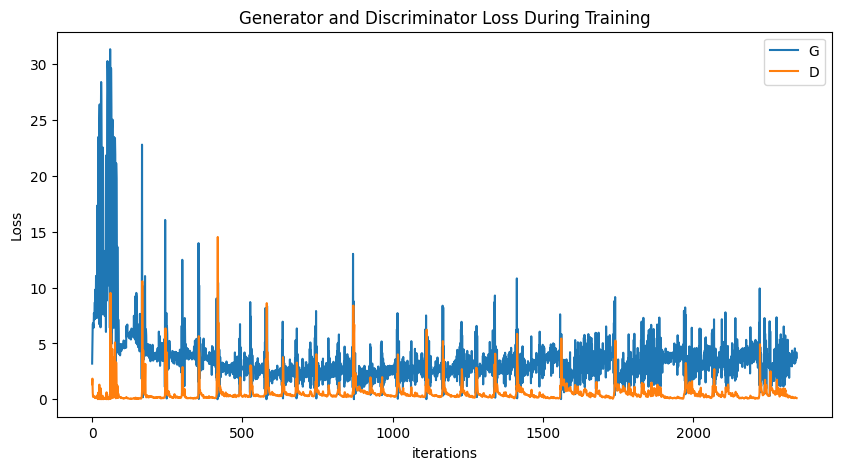

In [ ]:
plot_fun(G_losses_mnist,D_losses_mnist)

In [ ]:
def animation_plot(image_lis):
  fig = plt.figure(figsize=(8,8))
  plt.axis("off")
  ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in image_lis]
  ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

  HTML(ani.to_jshtml())

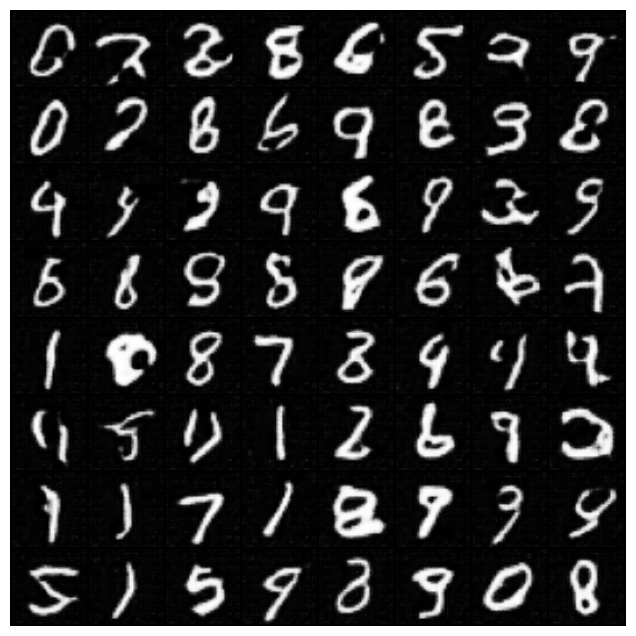

In [ ]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_mnist]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
def comparing_fun(dataloader,image_lis):
  # Grab a batch of real images from the dataloader
  real_batch = next(iter(dataloader))

  # Plot the real images
  plt.figure(figsize=(15,15))
  plt.subplot(1,2,1)
  plt.axis("off")
  plt.title("Real Images")
  plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

  # Plot the fake images from the last epoch
  plt.subplot(1,2,2)
  plt.axis("off")
  plt.title("Fake Images")
  plt.imshow(np.transpose(image_lis[-1],(1,2,0)))
  plt.show()


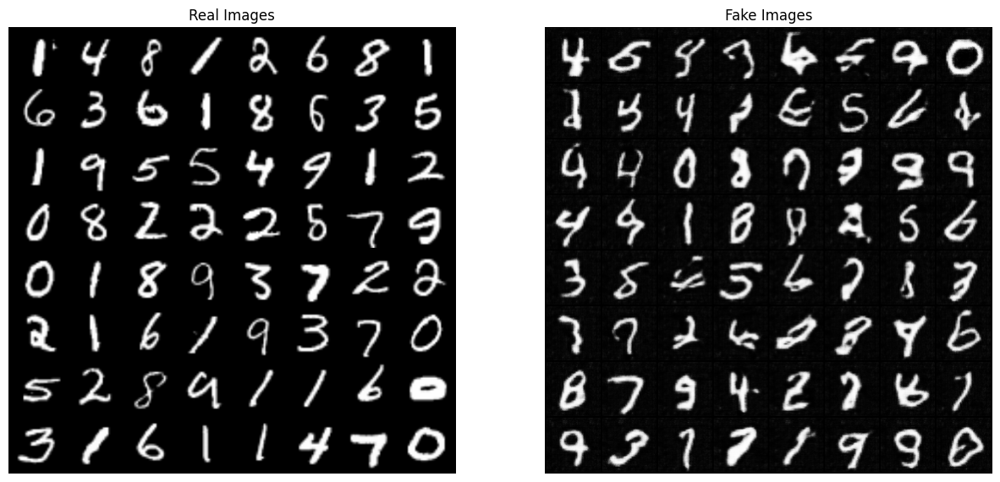

In [ ]:
comparing_fun(dataloader_mnist,img_list_mnist)

The second implementation: using Celba dataset.

In [ ]:
#The generator model
gen_model_celeba = Generator_Net(numb_gpu).to(device)

#Initalize the weights
gen_model_celeba.apply(initalize_weights)

In [ ]:
#The Discriminator model
dis_model_celeba = Discriminator_Net(numb_gpu).to(device)

#Initalize the weights
dis_model_celeba.apply(initalize_weights)


In [ ]:
# Loss function
criterion_cel = nn.BCELoss()

#Fixed batch for evaluating the progress of the generator
fixed_noise = torch.randn(64, size_of_z, 1, 1, device=device)

real_label = 1.
fake_label = 0.

#Adam optimizers
optimizerD_cel = optim.Adam(dis_model_celeba.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizerG_cel = optim.Adam(gen_model_celeba.parameters(), lr=learning_rate, betas=(beta1, 0.999))

In [ ]:
img_list_cel,G_losses_cel,D_losses_cel=train(dis_model_celeba,gen_model_celeba, criterion_cel, dataloader_celeba,optimizerD_cel,optimizerG_cel, num_epochs=5)

Starting Training Loop...
[0/5][0/1583]	Loss_D: 2.0641	Loss_G: 2.1483	D(x): 0.2610	D(G(z)): 0.3178 / 0.1564
[0/5][50/1583]	Loss_D: 1.5617	Loss_G: 21.0708	D(x): 0.9212	D(G(z)): 0.6512 / 0.0000
[0/5][100/1583]	Loss_D: 1.1077	Loss_G: 16.0987	D(x): 0.9803	D(G(z)): 0.5965 / 0.0000
[0/5][150/1583]	Loss_D: 0.3273	Loss_G: 4.5662	D(x): 0.8283	D(G(z)): 0.0874 / 0.0144
[0/5][200/1583]	Loss_D: 0.5533	Loss_G: 4.7253	D(x): 0.8211	D(G(z)): 0.2392 / 0.0136
[0/5][250/1583]	Loss_D: 0.7974	Loss_G: 7.4995	D(x): 0.9475	D(G(z)): 0.4356 / 0.0025
[0/5][300/1583]	Loss_D: 0.3010	Loss_G: 5.1890	D(x): 0.9556	D(G(z)): 0.2001 / 0.0108
[0/5][350/1583]	Loss_D: 1.1311	Loss_G: 3.2265	D(x): 0.4675	D(G(z)): 0.0326 / 0.0767
[0/5][400/1583]	Loss_D: 0.4931	Loss_G: 4.5925	D(x): 0.8521	D(G(z)): 0.2242 / 0.0208
[0/5][450/1583]	Loss_D: 0.5562	Loss_G: 4.6101	D(x): 0.6848	D(G(z)): 0.0215 / 0.0166
[0/5][500/1583]	Loss_D: 1.5665	Loss_G: 8.6958	D(x): 0.9120	D(G(z)): 0.6589 / 0.0031
[0/5][550/1583]	Loss_D: 0.4379	Loss_G: 5.0929	D(x):

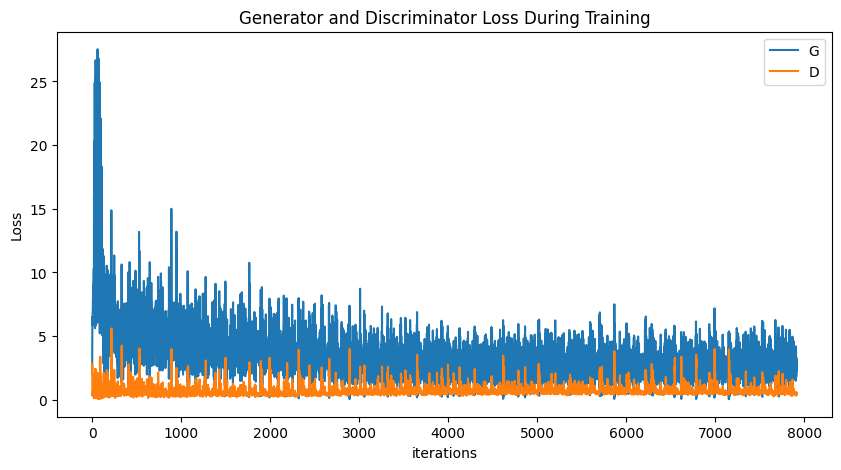

In [ ]:
plot_fun(G_losses_cel,D_losses_cel)

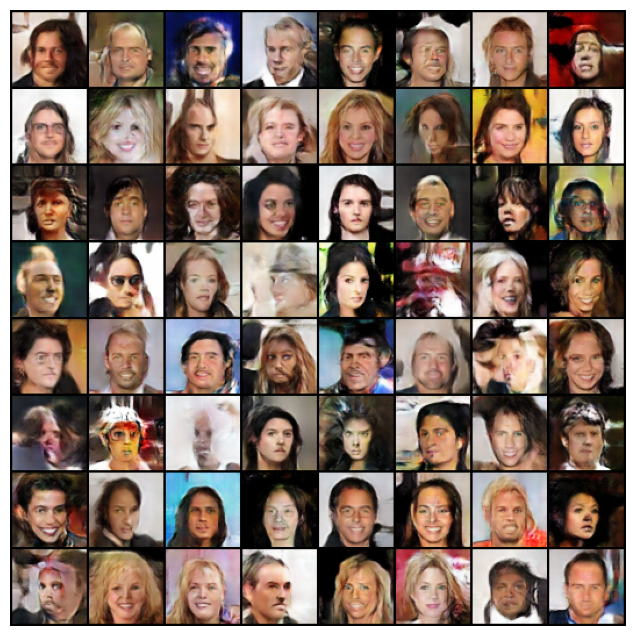

In [ ]:

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list_cel]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

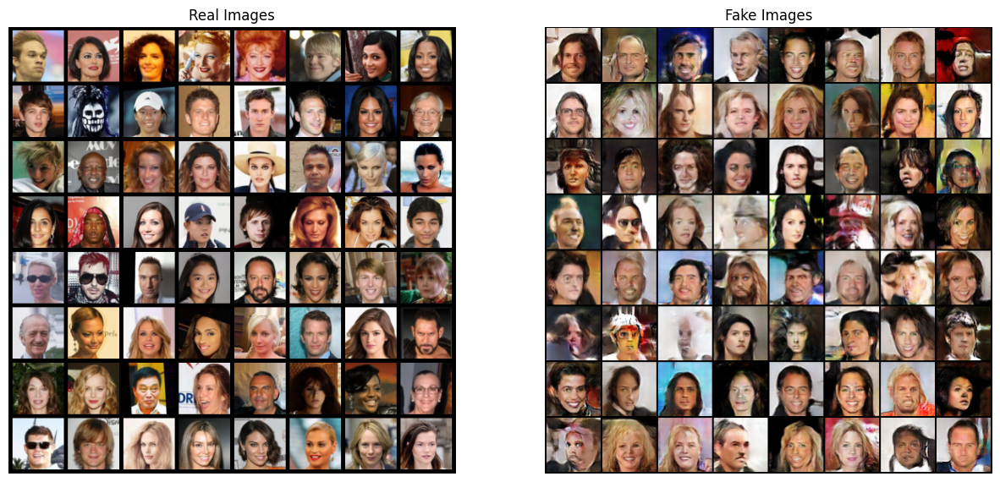

In [ ]:
comparing_fun(dataloader_celeba,img_list_cel)